STUDENT NAME: Ashena Gorgan Mohammadi

STUDENT NUMBER: 610398085

# INTRODUCTION
Morphological image processing is basically a collection of operations related to morphology of features inside an image. To be more precise, these methods are used to extract image components, e.g. the boundaries, skeleton, and shapes. Consequently, these methods are so useful in image processing. One can find objects with specific shapes in an image and draw the boundaries merely using these techniques.

In this exercise, we are going to use morphological operations to identify and count red and white cells in microscopic images. For this purpose, the ALL_IDB1 data set has been used. It contains 108 microscopic images in jpg format in RGB. This data set is extensively developed for the task of detecting blast cells and hence there is no label hint for images to identify white and red cells. However, we know that the cells in purple and pink are white and red blood cells respectively. As a result, we could only visually validate the performance. 

In the rest of this file, we are going to see the code and explanations of the methods used for the task. Note that the commented code cells are part of trial and errors of the implementation and are not part of the report. In the next section, we will describe the approach and the code to get over the task.

# METHODS
As mentioned before, these images are in RGB. However, there is no special cue in the color channels. So we basically prefered to convert them into grayscale to reduce complexity. Reviewing the images, they vary in intensity levels, making them harder to batch process. Let's first import the images and then explain the process to handle this issue.

##### Import required libraries

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

import sys
import os
import gc

from copy import deepcopy

##### Define image path

In [2]:
ALL_IDB1_PATH_IM = "../../HW2/ALL_IDB1/im/"

##### Load images and create a dataframe

In [3]:
idb1_images = {}
for file_name in os.listdir(ALL_IDB1_PATH_IM):
    idb1_images[file_name[:-6]] = {"image": cv2.imread(ALL_IDB1_PATH_IM+file_name), "class": file_name[-5]}

idb1_dataframe = pd.DataFrame.from_dict(idb1_images).transpose()

## Enhance Images
To overcome the issue mentioned, first convert each RGB image into an HSV. Then, we apply a contrast limited local histogram equalization on the value channel to relax the issue. We then convert the new HSV image into RGB. This result is converted into a grayscale image and a contrast stretching is applied at the end to ensure that all images have gray values in range [0, 255]. The resulting images are viewed in cell 7.

In [4]:
def contrast_enhancement(img):
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    h, s, v = cv2.split(hsv)
    clahe = cv2.createCLAHE(clipLimit=10, tileGridSize=(8,8))
    cl = clahe.apply(v)
    res = cv2.merge((h, s, v))
    rgb = cv2.cvtColor(res, cv2.COLOR_HSV2RGB)
    ret = cv2.cvtColor(rgb, cv2.COLOR_RGB2GRAY)
    ret = (ret - np.min(ret))*(255/(np.max(ret) - np.min(ret)))
    return cv2.convertScaleAbs(ret)

In [5]:
idb1_dataframe["image"] = idb1_dataframe["image"].apply(contrast_enhancement)

In [6]:
def plot_all(images):
    rows = int(np.ceil(len(images) / 10))
    i = 0
    fig, axes = plt.subplots(nrows = rows, ncols = 10, figsize=(30,30))
    for ind, x in images.items():
        plt.title(ind)
        plt.axis("off")
        axes[i//10,i%10].imshow(x, "gray")
        i += 1
    plt.show()

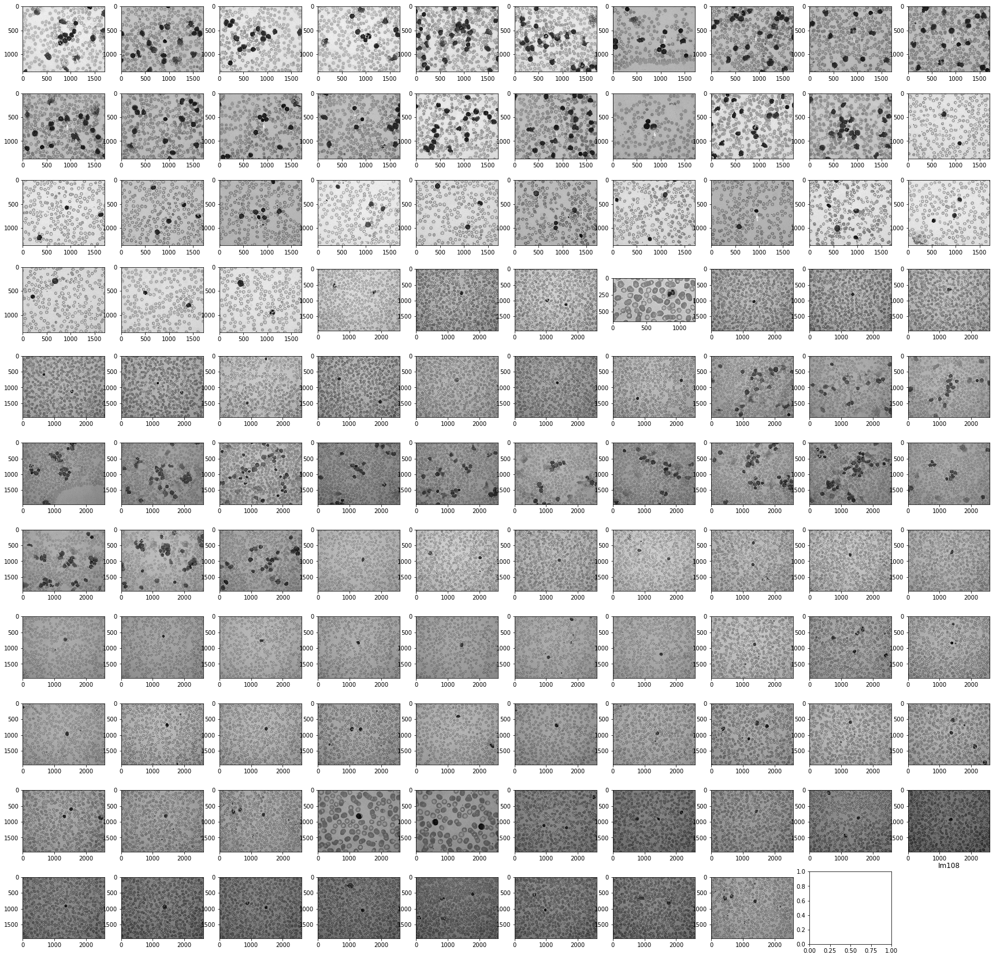

In [7]:
plot_all(idb1_dataframe["image"])

## Find and count white cells
As you can see in the above plot, some images are darker than the others. After discovering through their histograms, we observed that those darker images obtain intensity values of less than 180 while others ranged further. So we decided to add 50 degrees of intensity to those images with a maximum pixel value of less than 180. To make more difference among white and red cells(i.e. the darker cells from the light ones), we applied a slight power-law transform with gamma of 0.6. We then used thresholding to convert the grayscale image into a binary version and applied median blur with window size of 5 to smoothen the result.

The morphological processes begin here. There are some noisy white dots in each picture due to thresholding. To remove these noisy dots, we apply an opening filter with a disk of radius 16 on the image. We then apply a closing filter with a disk of radius 25 to fill in the small holes visible in the cells. Now that we have a quite neat binary image, we extract the boundaries using MORPH_GRADIENT which subtracts the dilated image from the eroded version of the image by a structuring element. We used a circle with a radius of 15 as the structuring element. Finally, we apply an erosion on the gradient image to make the borders more clear.

In order to count the cells, a circle hough transform is used. This transformation basically identifies the location of circles through the edges. It has got some parameters which had to be tuned thoroughly so that it can be practical to be applied on all the images. The parameter set used in here can be seen in the below code block. The HoughCircles function returns the description of the detected circles in a list. Using this, we specified the location of white cells and their count in each picture.

The results seem to be promising. Yet, there are some miss-computations as well which are negligible as the algorithm is doing good in most cases in spite of lack of label hints. The performance measure could be defined more precisely if the cell labels were available.

In [8]:
def count_white_cells(image, name):
    if np.max(image) <= 180:
        image += 50
    gamma_corrected = np.array(255*(image / 255) ** 0.6, dtype = 'uint8')
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15, 15))
    gamma_corrected = cv2.morphologyEx(gamma_corrected, cv2.MORPH_OPEN, kernel)
    if np.mean(gamma_corrected) > 155:
        thresh_im = cv2.threshold(gamma_corrected, 127, 255, cv2.THRESH_BINARY_INV)[1]
    else:
        thresh_im = cv2.threshold(gamma_corrected, 80, 255, cv2.THRESH_BINARY_INV)[1]
    blurred_im = cv2.medianBlur(thresh_im, 5)
    
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (16, 16))
    erode_im = cv2.morphologyEx(blurred_im, cv2.MORPH_OPEN, kernel)
    
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (25, 25))
    erode_im = cv2.morphologyEx(erode_im, cv2.MORPH_CLOSE, kernel)
    
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15, 15))
    edge_after_erode_im = cv2.morphologyEx(erode_im, cv2.MORPH_GRADIENT, kernel)
    
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (11, 11))
    edge_after_erode_im = cv2.erode(edge_after_erode_im, kernel, iterations=1)
    
    white_cells = cv2.HoughCircles(edge_after_erode_im, cv2.HOUGH_GRADIENT, 1, 75, 
                               param1=5, param2=20, minRadius=15, maxRadius=130)

    hough = deepcopy(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB))
    
    if white_cells is not None:
        white_cells = np.uint16(np.around(white_cells))
        for i in white_cells[0,:]:
            cv2.circle(hough,(i[0],i[1]),i[2],(0,255,0),8)
    
    fig = plt.figure(figsize=(20,20))
    fig.add_subplot(1,6,1)
    plt.imshow(image, "gray")
    fig.add_subplot(1,6,2)
    plt.imshow(gamma_corrected, "gray")
    fig.add_subplot(1,6,3)
    plt.imshow(blurred_im, "gray")
    fig.add_subplot(1,6,4)
    plt.imshow(erode_im, "gray")
    fig.add_subplot(1,6,5)
    plt.imshow(edge_after_erode_im, "gray")
    fig.add_subplot(1,6,6)
    plt.imshow(hough, "gray")
    fig.savefig("WHITE_{}.png".format(name))
    plt.show()
    plt.close()
        
    return gamma_corrected, blurred_im, erode_im, edge_after_erode_im, hough, white_cells

## Find and count red cells
To identify the red cells, we need a way to get away from the white ones. We used a hit and miss operation using a disc with radius 40. By subtracting the result from the original image, we achieve an image in which borders are stressed. The border colors define the cell color, so we use a two step thresholding to convert the image to its binary version; we first whiten out the darker borders which correspond to white cells and then apply the inverse binary thresholding on the resulting image.

Since the resulting image only includes the stressed boundaries, there is no need for further gradient operation. We just apply opening and erosion filters with discs of radius 7 and 2, respectively, to reduce the noise from the binary image. Finally, we apply the hough transform and return the results.

Note that red cells are normally small, however, there are two images with abnormal sizes. Hough Transform fails to find the cells correctly in those images. So we decided to define a different max Radius for those images in the hough transform.

In [9]:
def count_red_cells(image, name, max_radius=60):
    res = deepcopy(image)
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (40, 40))
    hitmiss = cv2.morphologyEx(res, cv2.MORPH_HITMISS, kernel)
    res = hitmiss - image
    
    whites = (res <= np.mean(res)-35)
    res[whites] = 255
    thresh_im = cv2.threshold(res, 220, 255, cv2.THRESH_BINARY_INV)[1]
    blurred_im = cv2.medianBlur(thresh_im, 5)
    
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7, 7))
    denoised = cv2.morphologyEx(blurred_im, cv2.MORPH_OPEN, kernel)
    
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (2, 2))
    grad = cv2.erode(denoised, kernel, iterations=1)
    
    red_cells = cv2.HoughCircles(grad, cv2.HOUGH_GRADIENT, 1, 60, 
                           param1=5, param2=16, minRadius=0, maxRadius=max_radius)

    hough = deepcopy(cv2.cvtColor(image, cv2.COLOR_GRAY2RGB))

    if red_cells is not None:
        red_cells = np.uint16(np.around(red_cells))
        for i in red_cells[0,:]:
            cv2.circle(hough,(i[0],i[1]),i[2],(255,0,0),8)
            
    fig = plt.figure(figsize=(20,20))
    fig.add_subplot(1,6,1)
    plt.imshow(image, "gray")
    fig.add_subplot(1,6,2)
    plt.imshow(res, "gray")
    fig.add_subplot(1,6,3)
    plt.imshow(blurred_im, "gray")
    fig.add_subplot(1,6,4)
    plt.imshow(denoised, "gray")
    fig.add_subplot(1,6,5)
    plt.imshow(grad, "gray")
    fig.add_subplot(1,6,6)
    plt.imshow(hough, "gray")
    fig.savefig("RED_{}.png".format(name))
    plt.show()
    plt.close()
        
    return res, blurred_im, denoised, grad, hough, red_cells

The images, from left to right, are the original image after enhancement, gamma corrected version, thresholded image, edited image using opening and closing operations, the gradient of image after erosion, and the result of hough transformation. The green circles on the right images identify the white cells.

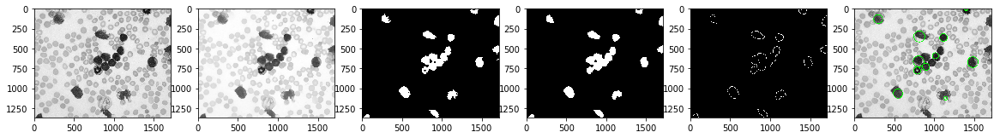

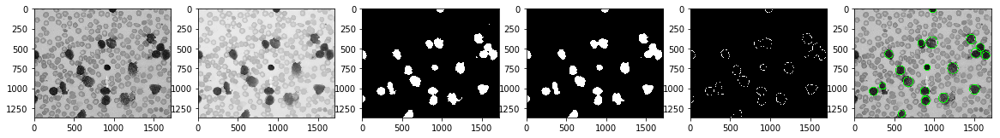

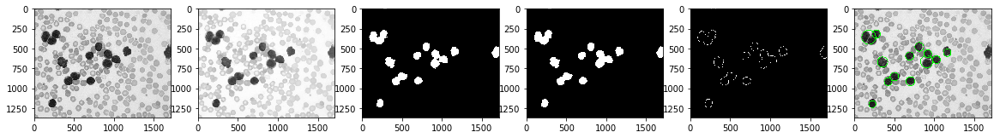

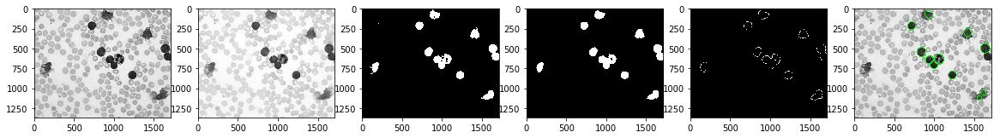

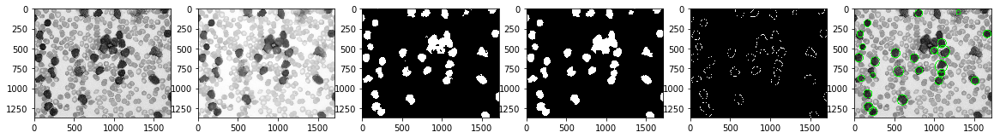

...

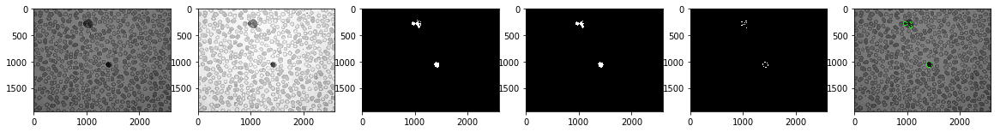

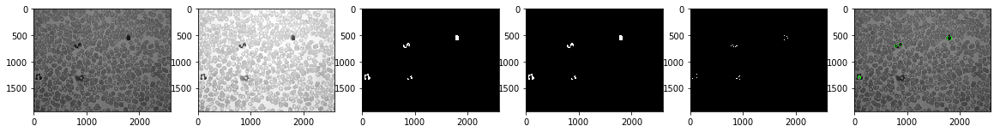

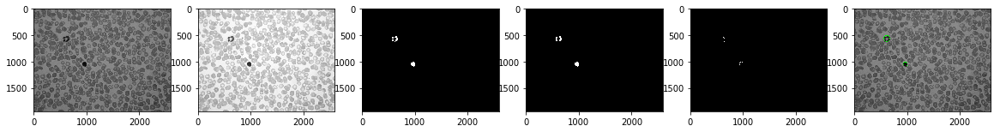

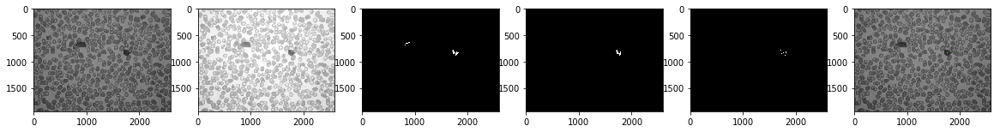

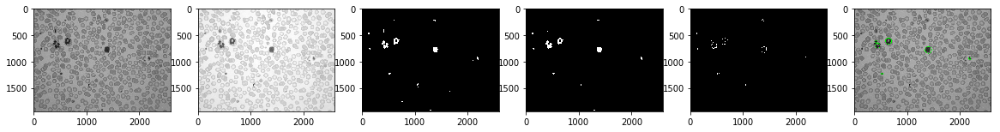

In [10]:
white_corrected_ims = {}
white_thresh_ims = {}
white_modified_ims = {}
white_grad_ims = {}
white_hough_ims = {}
white_counts = {}
for ind, im in idb1_dataframe["image"].items():
    gc.collect()
    gamma_corrected, blurred_im, erode_im, edge_after_erode_im, hough, cells = count_white_cells(im, ind)
    white_corrected_ims[ind] = gamma_corrected
    white_thresh_ims[ind] = blurred_im
    white_modified_ims[ind] = erode_im
    white_grad_ims[ind] = edge_after_erode_im
    white_hough_ims[ind] = hough
    white_counts[ind] = len(cells[0, :]) if cells is not None else 0

The images, from left to right, depict the original image, the result of removing borders of white cells from the output of subtraction of original image and hit and miss version, thresholded image, the thresholded image after applying the opening filter, the result after erosion, and the output of hough transform. The red circles identify the red blood cells. As you can see, some of them are missed but the hough transform parameters could not be tuned better to detect all of the cells. Changing the parameters reduced the precision and this was the best-achieved result.

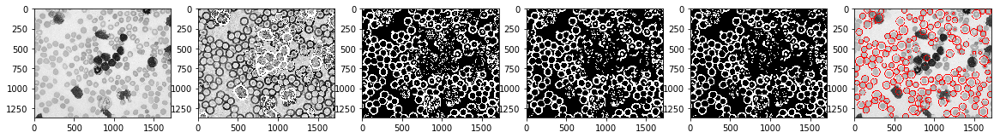

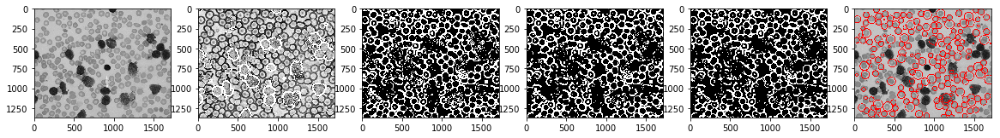

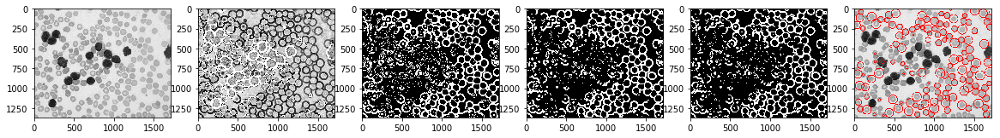

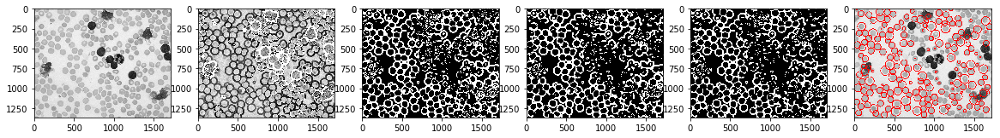

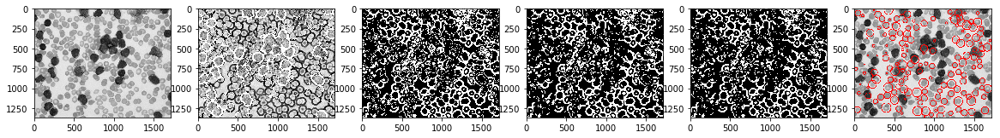

...

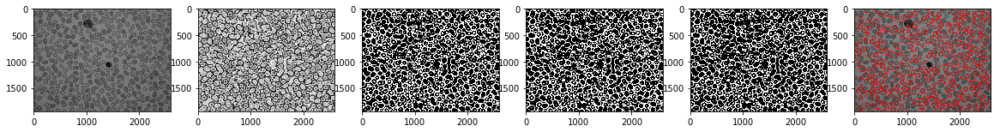

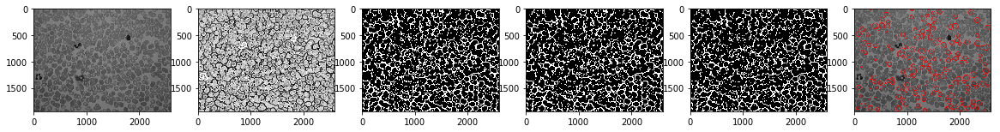

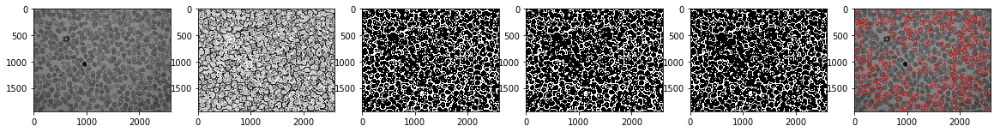

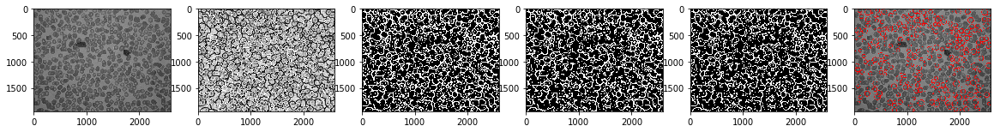

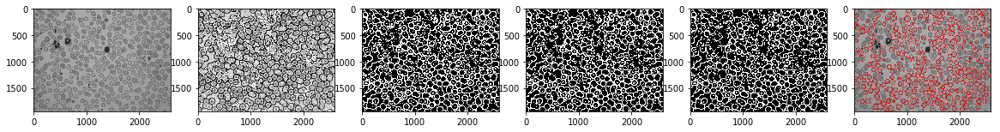

In [11]:
red_corrected_ims = {}
red_thresh_ims = {}
red_modified_ims = {}
red_grad_ims = {}
red_hough_ims = {}
red_counts = {}
for ind, im in idb1_dataframe["image"].items():
    gc.collect()
    if ind == "Im094" or ind == "Im095":
        gamma_corrected, blurred_im, erode_im, edge_after_erode_im, hough, cells = count_red_cells(im, ind, 100)
    else:
        gamma_corrected, blurred_im, erode_im, edge_after_erode_im, hough, cells = count_red_cells(im, ind)
    red_corrected_ims[ind] = gamma_corrected
    red_thresh_ims[ind] = blurred_im
    red_modified_ims[ind] = erode_im
    red_grad_ims[ind] = edge_after_erode_im
    red_hough_ims[ind] = hough
    red_counts[ind] = len(cells[0, :]) if cells is not None else 0

# CONCLUSION
In this exercise, we used different morphological operations. You can see the cell counts below. We have tested further combinations of operations as well which you can see in the commented cells below. The above ones were the most promising, though, and were more precise when validating them visually. We have seen the effect of opening, closing, and erosion so precisely throughout the exercise. We have also gained knowledge on other algorithms like convex hull, gradient, and hit-or-miss.

We examined different morphological algorithms to detect objects and/or reduce noise from images, namely hit-and-miss, top-hat, black-hat, thinning, thickening, gradients, and convex hull. We identified hit-and-miss as a useful algorithm to find objects. thinning and thickening also could enhance the boundaries. In a trial we also tried a convex hull to find the contours and it seemed to be an effective algorithm for the purpose. You can see some of our trials in the commented code cells below.

We could successfully count cells in microscopic images, using only morphological operations and hough transform. You might have noted that although we could count the red cells by subtracting the white count from the total count, we did not follow this approach so that we could get more acquainted with morphological operation capabilities. Morphological image processing is a powerful tool in segmenting images and detecting specific objects, as well as reducing some types of noise, such as salt-and-pepper. This tool can also be used to preprocess images before other tasks, such as classification or object detection.

In [12]:
idb1_dataframe["white_corrected"] = pd.Series(white_corrected_ims)
idb1_dataframe["white_thresh"] = pd.Series(white_thresh_ims)
idb1_dataframe["white_modified"] = pd.Series(white_modified_ims)
idb1_dataframe["white_gardient"] = pd.Series(white_grad_ims)
idb1_dataframe["white_hough"] = pd.Series(white_hough_ims)

idb1_dataframe["red_corrected"] = pd.Series(red_corrected_ims)
idb1_dataframe["red_thresh"] = pd.Series(red_thresh_ims)
idb1_dataframe["red_modified"] = pd.Series(red_modified_ims)
idb1_dataframe["red_gardient"] = pd.Series(red_grad_ims)
idb1_dataframe["red_hough"] = pd.Series(red_hough_ims)

idb1_dataframe["white_counts"] = pd.Series(white_counts)
idb1_dataframe["red_counts"] = pd.Series(red_counts)

In [13]:
for ind, row in idb1_dataframe.iterrows():
    print(ind, ">>> RED:", row["red_counts"], ", WHITE:", row["white_counts"])

Im001 >>> RED: 171 , WHITE: 11
Im002 >>> RED: 183 , WHITE: 19
Im003 >>> RED: 142 , WHITE: 13
Im004 >>> RED: 186 , WHITE: 11
Im005 >>> RED: 160 , WHITE: 25
Im006 >>> RED: 185 , WHITE: 20
Im007 >>> RED: 111 , WHITE: 13
Im008 >>> RED: 182 , WHITE: 19
Im009 >>> RED: 194 , WHITE: 12
Im010 >>> RED: 208 , WHITE: 17
Im011 >>> RED: 208 , WHITE: 20
Im012 >>> RED: 176 , WHITE: 15
Im013 >>> RED: 162 , WHITE: 12
Im014 >>> RED: 176 , WHITE: 10
Im015 >>> RED: 154 , WHITE: 20
Im016 >>> RED: 159 , WHITE: 22
Im017 >>> RED: 130 , WHITE: 3
Im018 >>> RED: 150 , WHITE: 14
Im019 >>> RED: 165 , WHITE: 19
Im020 >>> RED: 180 , WHITE: 2
Im021 >>> RED: 167 , WHITE: 3
Im022 >>> RED: 198 , WHITE: 5
Im023 >>> RED: 194 , WHITE: 8
Im024 >>> RED: 173 , WHITE: 4
Im025 >>> RED: 174 , WHITE: 3
Im026 >>> RED: 183 , WHITE: 5
Im027 >>> RED: 160 , WHITE: 3
Im028 >>> RED: 188 , WHITE: 2
Im029 >>> RED: 162 , WHITE: 4
Im030 >>> RED: 158 , WHITE: 3
Im031 >>> RED: 162 , WHITE: 2
Im032 >>> RED: 157 , WHITE: 2
Im033 >>> RED: 169 , W

In [14]:
# plot_all(idb1_dataframe["image"])

In [15]:
# plot_all(idb1_dataframe["white_modified"])

In [16]:
# plot_all(idb1_dataframe["white_gardient"])

In [17]:
# plot_all(idb1_dataframe["white_hough"])

In [18]:
# plot_all(idb1_dataframe["red_modified"])

In [19]:
# plot_all(idb1_dataframe["red_gardient"])

In [20]:
# plot_all(idb1_dataframe["red_hough"])

In [21]:
# fig = plt.figure(figsize=(50,50))
# fig.add_subplot(1,6,1)
# plt.imshow(image, "gray")
# fig.add_subplot(1,6,2)
# plt.imshow(gamma_corrected, "gray")
# fig.add_subplot(1,6,3)
# plt.imshow(blurred_im, "gray")
# fig.add_subplot(1,6,4)
# plt.imshow(erode_im, "gray")
# fig.add_subplot(1,6,5)
# plt.imshow(edge_after_erode_im, "gray")
# fig.add_subplot(1,6,6)
# plt.imshow(hough, "gray")
# fig.savefig("WHITE_{}.png".format(name))
# plt.show()
# plt.close()

        

# fig = plt.figure(figsize=(50,50))
# fig.add_subplot(1,6,1)
# plt.imshow(image, "gray")
# fig.add_subplot(1,6,2)
# plt.imshow(res, "gray")
# fig.add_subplot(1,6,3)
# plt.imshow(blurred_im, "gray")
# fig.add_subplot(1,6,4)
# plt.imshow(denoised, "gray")
# fig.add_subplot(1,6,5)
# plt.imshow(grad, "gray")
# fig.add_subplot(1,6,6)
# plt.imshow(hough, "gray")
# fig.savefig("RED_{}.png".format(name))
# plt.show()
# plt.close()

In [22]:
# def histogram_matching(src):
#     ref = idb1_images["Im001"]["image"]
#     src_hist, _ = np.histogram(src.flatten(), 256, [0, 256])
#     ref_hist, _ = np.histogram(ref.flatten(), 256, [0, 256])
    
#     src_cdf = src_hist.cumsum()
#     src_cdf = src_cdf / float(np.max(src_cdf))
#     ref_cdf = ref_hist.cumsum()
#     ref_cdf = ref_cdf / float(np.max(ref_cdf))
    
#     lookup_table = np.zeros(256)
#     lookup_val = 0
#     for src_pixel_val in range(len(src_cdf)):
#         lookup_val = 0
#         for ref_pixel_val in range(len(ref_cdf)):
#             if ref_cdf[ref_pixel_val] >= src_cdf[src_pixel_val]:
#                 lookup_val = ref_pixel_val
#                 break
#         lookup_table[src_pixel_val] = lookup_val
#     return cv2.LUT(src, lookup_table)

In [23]:
# test_image = idb1_dataframe["image"]["Im095"]
# plt.imshow(test_image, "gray")

In [24]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (40, 40))
# tophat = cv2.morphologyEx(test_image, cv2.MORPH_HITMISS, kernel)
# # res = tophat - test_image
# # whites = (res >= 120)
# # res[whites] = 0
# res = tophat - test_image
# plt.imshow(res, "gray")

In [25]:
# whites = (res <= np.mean(res)-35)
# res[whites] = np.max(res)
# thresh_im = cv2.threshold(res, 215, 255, cv2.THRESH_BINARY_INV)[1]
# blurred_im = cv2.medianBlur(thresh_im, 5)
# plt.imshow(blurred_im, "gray")

In [26]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
# denoised = cv2.morphologyEx(blurred_im, cv2.MORPH_OPEN, kernel)
# plt.imshow(denoised, "gray")

In [27]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
# hitmiss = cv2.morphologyEx(thresh_im, cv2.MORPH_ERODE, kernel)
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (12, 12))
# hitmiss = cv2.morphologyEx(hitmiss, cv2.MORPH_CLOSE, kernel)
# # kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7, 7))
# # hitmiss = cv2.erode(hitmiss, kernel, iterations=1)
# plt.imshow(hitmiss, "gray")

In [28]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15, 15))
# grad = cv2.morphologyEx(hitmiss, cv2.MORPH_GRADIENT, kernel)
# plt.imshow(grad, "gray")

In [29]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (2, 2))
# grad = cv2.erode(denoised, kernel, iterations=1)
# plt.imshow(grad, "gray")

In [30]:
# red_cells = cv2.HoughCircles(grad, cv2.HOUGH_GRADIENT, 1, 60, 
#                            param1=5, param2=16, minRadius=0, maxRadius=70)

# hough = deepcopy(cv2.cvtColor(test_image, cv2.COLOR_GRAY2RGB))

# if red_cells is not None:
#     red_cells = np.uint16(np.around(red_cells))
#     for i in red_cells[0,:]:
#         # draw the outer circle
#         cv2.circle(hough,(i[0],i[1]),i[2],(255,0,0),8)
        
# plt.imshow(hough, "gray")

In [31]:
# idb1_dataframe["image"]["Im001"].shape

In [32]:
# for ind, im in idb1_dataframe["image"].items():
#     print(ind)
#     plt.hist(im.ravel(), 256, [0,256])
#     plt.show()
#     plt.close()

In [33]:
# def count_white_cells_convex(image, plot=True):
#     gamma_corrected = (image - np.min(image))*(255/(np.max(image) - np.min(image)))
#     gamma_corrected = np.array(255*(image / 255) ** 0.6, dtype = 'uint8')
# #     gamma_corrected = 0.9 * (np.log(1 + np.float32(image)))
# #     gamma_corrected = cv2.convertScaleAbs(gamma_corrected)
# #     print(np.min(gamma_corrected), np.max(gamma_corrected))
#     thresh_im = cv2.threshold(gamma_corrected, 127, 255, cv2.THRESH_BINARY_INV)[1]
#     blurred_im = cv2.medianBlur(thresh_im, 5)
    
#     im2, contours, hierarchy = cv2.findContours(blurred_im, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
#     hull = []
#     for i in range(len(contours)):
#         hull.append(cv2.convexHull(contours[i].astype('int'), False))
#     hough = np.zeros((blurred_im.shape[0], blurred_im.shape[1], 3), np.uint8)
#     for i in range(len(hull)):
#         cv2.drawContours(hough, hull[i], -1, (0,255,0), 10, 8)
    
#     if plot:
#         fig = plt.figure(figsize=(50,50))
#         fig.add_subplot(1,4,1)
#         plt.imshow(image, "gray")
#         fig.add_subplot(1,4,2)
#         plt.imshow(gamma_corrected, "gray")
#         fig.add_subplot(1,4,3)
#         plt.imshow(blurred_im, "gray")
# #         fig.add_subplot(1,6,4)
# #         plt.imshow(erode_im, "gray")
# #         fig.add_subplot(1,6,5)
# #         plt.imshow(edge_after_erode_im, "gray")
#         fig.add_subplot(1,4,4)
#         plt.imshow(hough, "gray")
#         plt.show()
#         plt.close()
        
#     return hull

In [34]:
# def count_white_cells_hitmiss(image, plot=True):
#     kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (80, 80))
#     hitmiss = cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel)
    
#     thresh_im = cv2.threshold(hitmiss, 100, 255, cv2.THRESH_BINARY_INV)[1]
#     blurred_im = cv2.medianBlur(thresh_im, 5)
    
#     kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (10, 10))
#     erode_im = cv2.erode(blurred_im, kernel, iterations=1)
    
#     kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (10, 10))
#     grad = cv2.morphologyEx(erode_im, cv2.MORPH_GRADIENT, kernel)
    
#     white_cells = cv2.HoughCircles(grad, cv2.HOUGH_GRADIENT, 1, 75, 
#                                param1=5, param2=20, minRadius=15, maxRadius=130)

#     hough = np.zeros((grad.shape[0], grad.shape[1], 3), np.uint16)

#     if white_cells is not None:
#         white_cells = np.uint16(np.around(white_cells))
#         for i in white_cells[0,:]:
#             # draw the outer circle
#             cv2.circle(hough,(i[0],i[1]),i[2],(0,255,0),5)
            
#     if plot:
#         fig = plt.figure(figsize=(50,50))
#         fig.add_subplot(1,6,1)
#         plt.imshow(image, "gray")
#         fig.add_subplot(1,6,2)
#         plt.imshow(hitmiss, "gray")
#         fig.add_subplot(1,6,3)
#         plt.imshow(blurred_im, "gray")
#         fig.add_subplot(1,6,4)
#         plt.imshow(erode_im, "gray")
#         fig.add_subplot(1,6,5)
#         plt.imshow(grad, "gray")
#         fig.add_subplot(1,6,6)
#         plt.imshow(hough, "gray")
#         plt.show()
#         plt.close()
        
#     return white_cells

In [35]:
# for ind, im in idb1_dataframe["image"].items():
#     cells = count_white_cells_hitmiss(im)
#     print(ind, len(cells[0, :]) if cells is not None else 0)

In [36]:
# test_image = idb1_dataframe.iloc[7]["image"]
# plt.imshow(test_image, "gray")

In [37]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (200, 200))
# tophat = cv2.morphologyEx(test_image, cv2.MORPH_BLACKHAT, kernel)
# plt.imshow(tophat - test_image, "gray")

In [38]:
# thresh_im = cv2.threshold(tophat - test_image, 150, 255, cv2.THRESH_BINARY)[1]
# plt.imshow(thresh_im, "gray")

In [39]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (10, 10))
# hitmiss = cv2.morphologyEx(thresh_im, cv2.MORPH_OPEN, kernel)
# plt.imshow(hitmiss, "gray")

In [40]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (10, 10))
# hitmiss = cv2.morphologyEx(hitmiss, cv2.MORPH_CLOSE, kernel)
# plt.imshow(hitmiss, "gray")

In [41]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
# hitmiss = cv2.morphologyEx(hitmiss, cv2.MORPH_GRADIENT, kernel)
# plt.imshow(hitmiss, "gray")

In [42]:
# new = tophat - test_image
# thresh_im = cv2.threshold(new, 40, 255, cv2.THRESH_BINARY)[1]
# blurred_im = cv2.medianBlur(thresh_im, 5)
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (75, 75))
# out = cv2.morphologyEx(blurred_im, cv2.MORPH_OPEN, kernel)
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15, 15))
# erode_im = cv2.erode(out, kernel, iterations=1)
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (55, 55))
# erode_im = cv2.morphologyEx(erode_im, cv2.MORPH_OPEN, kernel)
# plt.imshow(thresh_im, "gray")

In [43]:
# thresh_im = cv2.threshold(tophat, 150, 255, cv2.THRESH_BINARY_INV)[1]
# plt.imshow(thresh_im, "gray")

In [44]:
# blurred_im = cv2.medianBlur(thresh_im, 5)
# plt.imshow(blurred_im, "gray")

In [45]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (60, 60))
# erode_im = cv2.erode(blurred_im, kernel, iterations=1)
# plt.imshow(erode_im, "gray")

In [46]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (10, 10))
# grad = cv2.morphologyEx(erode_im, cv2.MORPH_GRADIENT, kernel)
# plt.imshow(grad, "gray")

In [47]:
# white_cells = cv2.HoughCircles(hitmiss, cv2.HOUGH_GRADIENT, 1, 75, 
#                                param1=5, param2=20, minRadius=15, maxRadius=40)

# hough = np.zeros((hitmiss.shape[0], hitmiss.shape[1], 3), np.uint16)

# if white_cells is not None:
#     white_cells = np.uint16(np.around(white_cells))
#     for i in white_cells[0,:]:
#         # draw the outer circle
#         cv2.circle(hough,(i[0],i[1]),i[2],(0,255,0),5)

# fig = plt.figure(figsize=(50,50))
# fig.add_subplot(1,2,1)
# plt.imshow(test_image, "gray")
# fig.add_subplot(1,2,2)
# plt.imshow(hough, "gray")
# print(len(white_cells[0,:]))

In [48]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15, 15))
# closed_im = cv2.morphologyEx(blurred_im, cv2.MORPH_CLOSE, kernel)
# plt.imshow(closed_im, "gray")

In [49]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (20, 20))
# erode_im = cv2.erode(blurred_im, kernel, iterations=1)
# plt.imshow(erode_im, "gray")

In [50]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (9, 9))
# edge_after_erode_im = cv2.morphologyEx(erode_im, cv2.MORPH_GRADIENT, kernel)
# plt.imshow(edge_after_erode_im, "gray")

In [51]:
# white_cells = cv2.HoughCircles(edge_after_erode_im, cv2.HOUGH_GRADIENT, 1, 80, 
#                                param1=10, param2=20, minRadius=0, maxRadius=150)
# white_cells = np.uint16(np.around(white_cells))
# # print(white_cells)
# hough = np.zeros((edge_after_erode_im.shape[0], edge_after_erode_im.shape[1], 3), np.uint16)
# for i in white_cells[0,:]:
#     # draw the outer circle
#     cv2.circle(hough,(i[0],i[1]),i[2],(0,255,0),2)
# plt.imshow(hough, "gray")

In [52]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (9, 9))
# edge_after_closed_im = cv2.morphologyEx(closed_im, cv2.MORPH_GRADIENT, kernel)
# plt.imshow(edge_after_closed_im, "gray")

In [53]:
# white_cells = cv2.HoughCircles(edge_after_closed_im, cv2.HOUGH_GRADIENT, 1, 80, 
#                                param1=10, param2=20, minRadius=0, maxRadius=150)
# white_cells = np.uint16(np.around(white_cells))
# # print(white_cells)
# hough = np.zeros((edge_after_erode_im.shape[0], edge_after_erode_im.shape[1], 3), np.uint16)
# for i in white_cells[0,:]:
#     # draw the outer circle
#     cv2.circle(hough,(i[0],i[1]),i[2],(0,255,0),2)
# plt.imshow(hough, "gray")

In [54]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (20, 20))
# erode_on_closed_im = cv2.erode(closed_im, kernel, iterations=1)
# plt.imshow(erode_on_closed_im, "gray")

In [55]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (25, 25))
# filt_im = cv2.erode(out_im, kernel, iterations=1)
# plt.imshow(filt_im, "gray")

In [56]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (40, 40))
# filt_im = cv2.morphologyEx(filt_im, cv2.MORPH_HITMISS, kernel)
# plt.imshow(filt_im, "gray")

In [57]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15, 15))
# filt_im = cv2.erode(filt_im, kernel, iterations=1)
# plt.imshow(filt_im, "gray")

In [58]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (9, 9))
# filt_im = cv2.morphologyEx(filt_im, cv2.MORPH_GRADIENT, kernel)
# plt.imshow(filt_im, "gray")

In [59]:
# # filt_im = cv2.threshold(out_im, 128, 255, cv2.THRESH_BINARY_INV)[1]
# # kernel = np.array(
# #     [[1, 0, -1],
# #      [2, 0, -2],
# #      [1, 0, -1]]
# # )
# # filt_im1 = cv2.filter2D(filt_im, -1, kernel)
# # kernel = kernel.transpose()
# # filt_im2 = cv2.filter2D(filt_im, -1, kernel)
# filt1 = cv2.Sobel(out_im,cv2.CV_64F,1,0,ksize=15)
# filt2 = cv2.Sobel(out_im,cv2.CV_64F,0,1,ksize=15)
# filt_im = filt_im1 + filt_im2
# plt.imshow(filt_im, "gray")

In [60]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
# filt_im = cv2.erode(filt_im, kernel, iterations=1)
# plt.imshow(filt_im, "gray")

In [61]:
# # kernel = np.ones((25,25), np.uint8)
# filt_im = out_im
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (25, 25))
# filt_im = cv2.morphologyEx(filt_im, cv2.MORPH_CLOSE, kernel)
# plt.imshow(filt_im, "gray")

In [62]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (12, 12))
# filt_im = cv2.morphologyEx(filt_im, cv2.MORPH_OPEN, kernel)
# plt.imshow(filt_im, "gray")

In [63]:
# # kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15, 15))
# # filt_im = cv2.morphologyEx(filt_im, cv2.MORPH_OPEN, kernel)
# filt_im = cv2.threshold(filt_im, 128, 255, cv2.THRESH_BINARY_INV)[1]
# # kernel = np.zeros((30,30), np.uint8)
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (65, 65))
# filt_im = cv2.erode(filt_im, kernel, iterations=1)
# # kernel = np.ones((10,10), np.uint8)
# plt.imshow(filt_im, "gray")

In [64]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (10, 10))
# filt_im = cv2.morphologyEx(filt_im, cv2.MORPH_GRADIENT, kernel)
# plt.imshow(filt_im, "gray")

In [65]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (350, 350))
# open_im = cv2.morphologyEx(test_image, cv2.MORPH_CLOSE, kernel)
# new_im = test_image - open_im
# thresh_new_im = cv2.threshold(new_im, 128, 255, cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU)[1]
# plt.imshow(thresh_new_im, "gray")

In [66]:
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (9, 9))
# new_im = cv2.morphologyEx(thresh_new_im, cv2.MORPH_GRADIENT, kernel)
# plt.imshow(new_im, "gray")

In [67]:
# white_cells = cv2.HoughCircles(new_im, cv2.HOUGH_GRADIENT, 1, 80, 
#                                param1=10, param2=20, minRadius=0, maxRadius=100)
# white_cells = np.uint16(np.around(white_cells))
# # print(white_cells)
# hough = np.zeros((edge_after_erode_im.shape[0], edge_after_erode_im.shape[1], 3), np.uint16)
# for i in white_cells[0,:]:
#     # draw the outer circle
#     cv2.circle(hough,(i[0],i[1]),i[2],(0,255,0),2)
# plt.imshow(hough, "gray")

In [68]:
# idb1_annots = {}
# for file_name in os.listdir(ALL_IDB1_PATH_XYC):
#     idb1_annots[file_name[:-6]] = []
#     with open(ALL_IDB1_PATH_XYC+file_name, 'r') as file:
#         content = file.readlines()
#         for line in content:
#             if line.split():
#                 idb1_annots[file_name[:-6]].append(list(map(int, line.split())))